In [15]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier #Import Random Forest Model
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from collections import Counter
from sklearn.metrics import classification_report
import seaborn as sns

# 1. Get Data
Data is the cleaned .csv file from previous project

In [2]:
# load original project data
df = pd.read_csv('resources/data/epicuriousity.csv')

# 2. Clean, Prepare and Manipulate Data
Steps performed in previous project to clean data
1. Loaded full_format_recipes.json from the Kaggle site
2. Drop Nan records
3. Create new columns to count # of ingredients and tags
4. Drop recipes with calories in the outliers
5. Drop recipes with 0 calories
6. Create a 'normalized' rating column to bin all recipes into 0, 1, 2, 3 and 4 star ratings

## Additional cleaning steps
1. Drop all columns we don't need keeping the following: calories, fat, protein, ingredients_count, tags_count and normalized rating
2. Drop all rows with 0 as rating (0 rating means recipe has not been rated)
3. Rename the 'rating_normalized" column to label as this is the known value

In [3]:
# drop columns we don't need
df.drop(['directions', 'date', 'tags', 'desc', 'rating', 'title', 'ingredients', 'sodium', 'vegan', 'vegetarian', 
        'organic', 'healthy', 'quick', 'low_carb', 'pescatarian', 'fat_free', 'high_fiber', 'kid_friendly', 
        'kosher', 'low_cal', 'no_cook', 'paleo', 'picnic', 'easy', 'slow_cooker', 'gluten_free', 'low_fat'], 
        axis = 1, inplace=True) 

# drop rows with 0 as rating as it means recipe has not been rated
cond = df['rating_normalized'] == 0
df.drop(df[cond].index, inplace=True)

# reset index after dropping dta
df.reset_index(drop=True, inplace=True)

# rename the rating_normalized to "label" which is the known classificer
df.rename(columns={'rating_normalized':'label'}, inplace=True)
df.head()

,fat,calories,protein,ingredients_count,tags_count,label
0,23.0,403.0,18.0,28,11,4
1,79.0,948.0,19.0,9,10,4
2,10.0,170.0,7.0,10,8,4
3,41.0,602.0,23.0,17,16,3
4,5.0,256.0,4.0,7,10,3


# 3. Train Model

In [4]:
#split dataset in features and target variable
feature_cols = ['fat', 'calories', 'protein', 'ingredients_count','tags_count']
target_names = ['1 Stars', '2 Stars', '3 Stars', '4 Stars']
X = df[feature_cols] # Features
y = df.label # Target variable

In [5]:
# Split dataset into training set and test set
# 70% training and 30% test
# random state set to keep same split across computers
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) 

In [6]:
print(f'Train {Counter(y_train)}')
print(f'Test {Counter(y_test)}')

Train Counter({4: 4081, 3: 2323, 2: 190, 1: 87})
Test Counter({4: 1742, 3: 1008, 2: 75, 1: 39})


In [7]:
#Create a Gaussian Classifier using 100 trees
clf=RandomForestClassifier(n_estimators=100)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

# 4. Test Data

In [9]:
acc = clf.score(X_test, y_test) # only score on the test
print(f"Accuracy = {acc}")

accuracy = 0.6197625698324022


In [10]:
# test data on the model/predict values
y_pred=clf.predict(X_test)

In [11]:
# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.6197625698324022


In [12]:
# https://towardsdatascience.com/an-implementation-and-explanation-of-the-random-forest-in-python-77bf308a9b76
n_nodes = []
max_depths = []

# Stats about the trees in random forest
for ind_tree in clf.estimators_:
    n_nodes.append(ind_tree.tree_.node_count)
    max_depths.append(ind_tree.tree_.max_depth)
    
print(f'Average number of nodes {int(np.mean(n_nodes))}')
print(f'Average maximum depth {int(np.mean(max_depths))}')

Average number of nodes 3583
Average maximum depth 31


In [13]:
# classification report
print(classification_report(clf.predict(X_test), y_test, target_names=target_names)) 

              precision    recall  f1-score   support

     1 Stars       0.13      0.83      0.22         6
     2 Stars       0.07      0.62      0.12         8
     3 Stars       0.31      0.50      0.38       628
     4 Stars       0.83      0.65      0.73      2222

   micro avg       0.62      0.62      0.62      2864
   macro avg       0.33      0.65      0.36      2864
weighted avg       0.72      0.62      0.65      2864



In [21]:
# classification report
print(classification_report(clf.predict(X_test), y_test, target_names=target_names)) 

              precision    recall  f1-score   support

           1       0.13      1.00      0.23         5
           2       0.07      0.71      0.12         7
           3       0.31      0.50      0.38       626
           4       0.84      0.66      0.74      2226

   micro avg       0.62      0.62      0.62      2864
   macro avg       0.34      0.72      0.37      2864
weighted avg       0.72      0.62      0.66      2864



In [16]:
# https://stats.stackexchange.com/questions/95209/how-can-i-interpret-sklearn-confusion-matrix
df_precision = pd.crosstab(y_test, y_pred, rownames=['Actual Ratings'], colnames=['Predicted Ratings'], margins=True)
# of recipes predicted correctly
# true predicted / actual true values gives precision



# Plot number of recipes predicted correctly
cm = sns.light_palette("teal", as_cmap=True)

df_precision.style.set_caption('# of Recipes Predicted Correctly')\
    .background_gradient(cmap=cm)

Predicted Ratings,1,2,3,4,All
Actual Ratings,,,,,
1,5,0,12,22,39
2,0,5,18,52,75
3,1,2,311,694,1008
4,0,1,287,1454,1742
All,6,8,628,2222,2864


In [81]:
# Plot % of recipes predicted correctly
# df_recall = pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted']).apply(lambda r: 100.0 * r/r.sum())
# # result is in percentage of how predicted
# # this is the recal values - diagonal values represent numbers
# # # of true predicted / all predicted

# df_recall.style.set_caption('% of Recipes Predicted Correctly')\
#     .background_gradient(cmap=cm)

## Test Results in English
The accuracy for the intial random forest model of 100 trees is 62%.  While that is not a stellar result, the classification report will further clarify that accuracy.

Reviewing the classification report we find we have better precision predicting 4 and 3 star ratings than we do 2 and 1 stars.  Precision indicates recipe ratings that were predicted correctly compared to true ratings for each category.  Using the colored dataframe below, we see the number recipes predicted 4 stars correctly is 1,460 out of a total of 1,742 actual 4 star recipes. 5 recipes were predicted correctly as 1 star ratings out of a total of 39 actual 1 star rating recipes.

The inverse is observed for recall with 1 and 2 star ratings having better recall and 3 and 4 star ratings. Recall indicates recipe ratings that were predicted correctly compared to all predictions for each category. Again, using the colored dataframe below we see that the number of recipes predicted 1 star correctly is 5 out of a total of 5 1 star predictions.  1,460 recipes were predicted 4 stars correctly out of a total of 2,226 recipes predicted to be 4 stars.

The F score represents the mean average of both the precision and recall in the model.  The support values of the classification report reflects the imbalance of data noted in the data exploration - we have very few 1 and 2 star recipes as compared to 4 star recipes.  This model shows its pretty good at predicting 4 star ratings (f-score of 71%) but is poor at predicting anything less than 4 stars.

## Feature Importance
Let's quantify the usefullness of the features provided by reviewing their relative importance in predicting values. This random forest model found calories to be the most important feature meaning the best predictor of star ratings is the calories per serving of each recipe.  Fat and protein per serving are the next two with each having a similar level of importance.  The number of ingredients had the least impact on the score.  Future revisions of the model could remove the features of least importance and see how the accuracy changes without those values present.

No handles with labels found to put in legend.


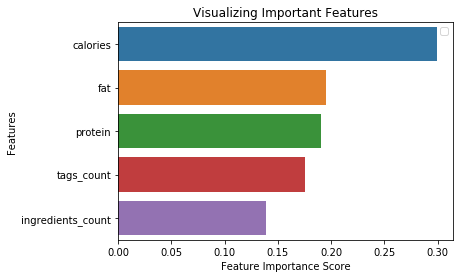

In [17]:
# review feature importance
feature_imp = pd.Series(clf.feature_importances_,index=feature_cols).sort_values(ascending=False)
# feature_imp

# visualize feature importance
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
# Creating a bar plot
sns.barplot(x=feature_imp, y=feature_imp.index)
# Add labels to your graph
plt.xlabel('Feature Importance Score')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
plt.legend()
plt.show()

# Improve
To improve our model, we will apply an oversampling and undersampling technique and compare results to see how they affected the model.

### SMOTE - (Synthetic Minority Over-sampling Technique)
SMOTE is an oversampling technique that creates synthetic samples of miniority classes. In our data, we have far more 4 star rated recipes than 3, 2 or 1 stars.  We'll use SMOTE to bring the number of recipes with 1, 2 and 3 stars closer to the number of recipes with 4 stars.

### Near Miss 
NearMiss is an undersampling technique that will make the majority class equal to the minority class. In our data, it will reduce the number of 4 and 3 star rating recipes to be closer to the 1 and 2 star ratings.

In [18]:
# check training data counts before applying SMOTE & Near Miss
print(f'Train before SMOTE {Counter(y_train)}')

Train before SMOTE Counter({4: 4081, 3: 2323, 2: 190, 1: 87})


In [22]:
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import NearMiss
from imblearn.metrics import classification_report_imbalanced
from imblearn.pipeline import make_pipeline as make_pipeline_imb
from sklearn.pipeline import make_pipeline

In [23]:
# fit for SMOTE
smt = SMOTE(random_state=42)
X_train_smt, y_train_smt = smt.fit_sample(X_train, y_train)

# see how SMOTE changed the count of our training set
Counter(y_train_smt)

Counter({3: 4081, 4: 4081, 2: 4081, 1: 4081})

In [129]:
# fit for SMOTE
smt = SMOTE(random_state=42)
X_train_smt, y_train_smt = smt.fit_sample(X_train, y_train)

# see how SMOTE changed the count of our training set
Counter(y_train_smt)

Counter({3: 4081, 4: 4081, 2: 4081, 1: 4081})

In [150]:
help(smt.fit_sample)

Help on method fit_resample in module imblearn.base:

fit_resample(X, y) method of imblearn.over_sampling._smote.SMOTE instance
    Resample the dataset.
    
    Parameters
    ----------
    X : {array-like, sparse matrix}, shape (n_samples, n_features)
        Matrix containing the data which have to be sampled.
    
    y : array-like, shape (n_samples,)
        Corresponding label for each sample in X.
    
    Returns
    -------
    X_resampled : {array-like, sparse matrix}, shape (n_samples_new, n_features)
        The array containing the resampled data.
    
    y_resampled : array-like, shape (n_samples_new,)
        The corresponding label of `X_resampled`.



In [24]:
#Create a Gaussian Classifier using 100 trees
clf_smt = RandomForestClassifier(n_estimators=100, random_state=42)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf_smt.fit(X_train_smt,y_train_smt)

# test data on the model/predict values using same test data
y_pred_smt=clf_smt.predict(X_test)

In [25]:
# Model Accuracy, how often is the classifier correct?
print("SMOTE Accuracy:",metrics.accuracy_score(y_test, y_pred_smt))

SMOTE Accuracy: 0.5799581005586593


In [26]:
# classification report
print('Original Classification Report')
print(classification_report(clf.predict(X_test), y_test, target_names=target_names)) 

Original Classification Report
              precision    recall  f1-score   support

     1 Stars       0.13      0.83      0.22         6
     2 Stars       0.07      0.62      0.12         8
     3 Stars       0.31      0.50      0.38       628
     4 Stars       0.83      0.65      0.73      2222

   micro avg       0.62      0.62      0.62      2864
   macro avg       0.33      0.65      0.36      2864
weighted avg       0.72      0.62      0.65      2864



In [28]:
# review classification report from imbalanced classifier
print("SMOTE Classification Report")
print(classification_report_imbalanced(y_test, y_pred_smt))

SMOTE Classification Report
                   pre       rec       spe        f1       geo       iba       sup

          1       0.16      0.18      0.99      0.17      0.42      0.16        39
          2       0.16      0.13      0.98      0.15      0.36      0.12        75
          3       0.46      0.38      0.75      0.42      0.54      0.28      1008
          4       0.66      0.72      0.42      0.69      0.55      0.31      1742

avg / total       0.57      0.58      0.56      0.57      0.54      0.29      2864



In [143]:
Counter(y_test)

Counter({4: 1742, 3: 1008, 2: 75, 1: 39})

#### SMOTE Results
Using the SMOTE technique our Accuracy dropped to 58%.  Revewing the SMOTE classification report, we see the SMOTING process increased the precision values for 2 and 3 star recipes, but significantly reduced 4 star recipes.  The recall scores all drastically dropped for 1, 2 and 3 star ratings but increased for 4 stars.  The al

In [ ]:
# using the same random forest classifier, 

In [38]:
# plot a single decision tree4

from sklearn.externals.six import StringIO  
from IPython.display import Image 
# Import tools needed for visualization
from sklearn.tree import export_graphviz
# import pydot
# Pull out one tree from the forest
tree = clf.estimators_[5]
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydotplus
# Pull out one tree from the forest
tree = clf.estimators_[5]

dot_data = StringIO()
export_graphviz(tree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_cols,class_names=['1','2', '3', '4'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('DT2.png')
Image(graph.create_png())



# # Export the image to a dot file
# export_graphviz(tree, out_file = 'tree.dot', feature_names = feature_cols, rounded = True, precision = 1)
# # Use dot file to create a graph
# (graph, ) = pydotplus.graph_from_dot_file('tree.dot')
# # Write graph to a png file
# graph.write_png('tree.png')

In [19]:
# not sure how to make this work so commenting out for now

# Probabilities for each class
# https://stackoverflow.com/questions/50941223/plotting-roc-curve-with-multiple-classes

# y_probs = clf.predict_proba(X_test)

# y_probs

In [ ]:
#Create a Gaussian Classifier
clf=RandomForestClassifier(n_estimators=300)

#Train the model using the training sets y_pred=clf.predict(X_test)
clf.fit(X_train,y_train)

y_pred=clf.predict(X_test)

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

In [ ]:
# https://towardsdatascience.com/an-implementation-and-explanation-of-the-random-forest-in-python-77bf308a9b76

n_nodes = []
max_depths = []

# Stats about the trees in random forest
for ind_tree in clf.estimators_:
    n_nodes.append(ind_tree.tree_.node_count)
    max_depths.append(ind_tree.tree_.max_depth)
    
print(f'Average number of nodes {int(np.mean(n_nodes))}')
print(f'Average maximum depth {int(np.mean(max_depths))}')

In [ ]:
print(classification_report(clf.predict(X_test), y_test, target_names=['1', '2', '3', '4'])) 
# precision: Precision is the ability of a classiifer not to label an instance positive that is actually negative. 
# For each class it is defined as as the ratio of true positives to the sum of true and false positives. 
# Said another way, “for all instances classified positive, what percent was correct?”

# Recall is the ability of a classifier to find all positive instances. For each class it is defined as the 
# ratio of true positives to the sum of true positives and false negatives. 
# Said another way, “for all instances that were actually positive, what percent was classified correctly?”



In [ ]:
print(f'Count of training data {Counter(y_train)}')
print(f'Count of test data {Counter(y_test)}')

In [ ]:
# Actual class predictions
rf_predictions = model.predict(test)
# Probabilities for each class
rf_probs = model.predict_proba(test)[:, 1]

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

cm = metrics.confusion_matrix(y_test, y_pred)
# or
#cm = np.array([[1401,    0],[1112, 0]])

plt.imshow(cm, cmap=plt.cm.Blues)
plt.xlabel("Predicted labels")
plt.ylabel("True labels")
plt.xticks([], [])
plt.yticks([], [])
plt.title('Confusion matrix ')
plt.colorbar()
plt.show()

In [ ]:
# https://stats.stackexchange.com/questions/95209/how-can-i-interpret-sklearn-confusion-matrix
pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted'], margins=True)
# of recipes predicted correctly
# true predicted / actual true values gives precision

In [ ]:
pd.crosstab(y_test, y_pred, rownames=['True'], colnames=['Predicted']).apply(lambda r: 100.0 * r/r.sum())
# result is in percentage of how predicted
# this is the recal values - diagonal values represent numbers
# # of true predicted / all predicted

In [ ]:
# next steps is SMOTE & Near Miss to see if balancing the data changes